In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Q1. Filter design using Hamming Window technique

The Ideal Low pass Frequency response with $F_c$ = 300 Hz, Hence $\Omega_c$ = 600 $\pi$. 

In discrete time, $\omega_c = \Omega_c \cdot T_s$

Hence $\omega_c = 0.06 \pi$


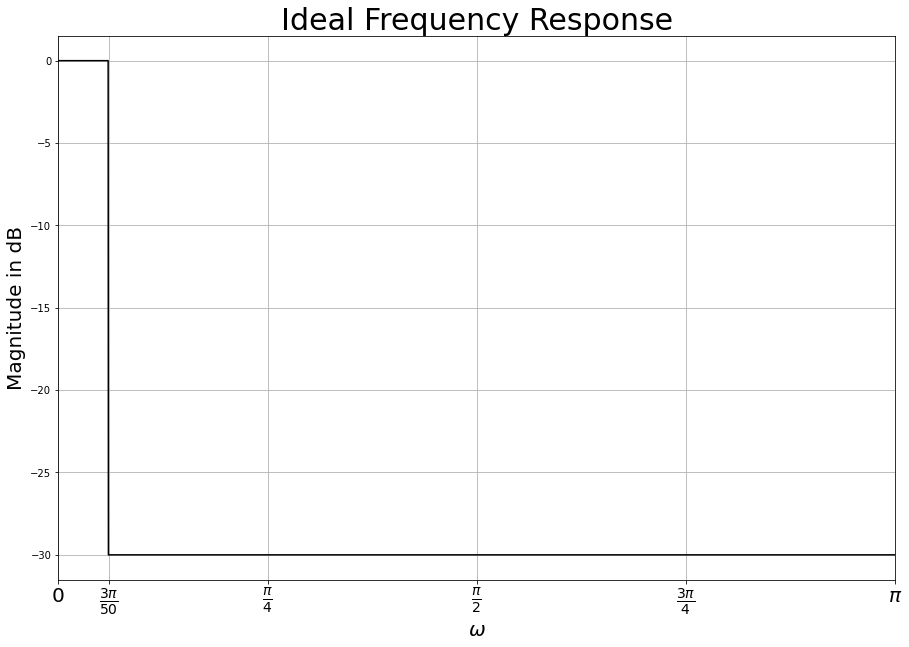

In [ ]:
wc = 0.06*np.pi

resolution = 0.001
Total = int(6.28 / resolution)

stopband = 30

w = np.arange(0,6.28,resolution)

ones_samples = int(wc / resolution)
zero_samples = Total - ones_samples
H1 = np.zeros((ones_samples,))
H2 = np.zeros((zero_samples,)) - stopband

H = np.concatenate((H1,H2),axis=0)

plt.figure(figsize = (15,10))
plt.title("Ideal Frequency Response",fontsize = 30)
plt.xlabel("$\omega$",fontsize = 20)
plt.ylabel("Magnitude in dB",fontsize = 20)
plt.grid()
plt.plot(w,H,color="k")
plt.xlim(0,3.14)
plt.xticks([0,0.06*np.pi,np.pi/4,np.pi/2,3*np.pi/4,np.pi],["0",r"$\frac{3\pi}{50}$",r"$\frac{\pi}{4}$",r"$\frac{\pi}{2}$",r"$\frac{3\pi}{4}$",r"$\pi$"],fontsize = 20)
plt.show()


Corresponding impulse response is given by :   

$h[n] = \frac{sin(\omega_c n)}{n\pi}$

$h[n] = \frac{sin(0.06\pi n)}{n\pi}$

$h[n] = 0.06 \cdot sinc (0.06 n)$

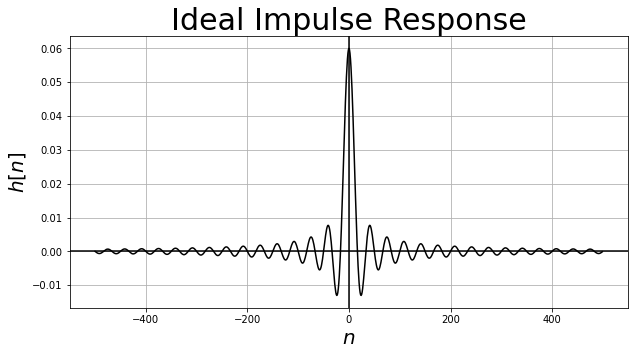

In [ ]:
n = np.arange(-500,500)
h = 0.06*np.sinc(0.06*n)

plt.figure(figsize = (10,5))
plt.title("Ideal Impulse Response",fontsize = 30)
plt.xlabel("$n$",fontsize = 20)
plt.ylabel("$h[n]$",fontsize = 20)
plt.grid()
plt.plot(n,h,color="k")
plt.axhline(color="k")
plt.axvline(color="k")
plt.show()

Now, we window the signal using a Hamming Window.

Pass band edge = 0.052 $\pi$

Stop band edge = 0.068 $\pi$

In [ ]:
def windowing(h, N):
  Total = 6280
  K = len(h) // 2
  hamming = np.hamming(N)
  extract = h[int(K - N//2) : int(K + N //2)]
  windowed = np.concatenate((extract*hamming, np.zeros((Total - len(extract*hamming)))),axis=0)

  return windowed

def get_xticks():
  index = [0,0.052*np.pi,0.068*np.pi,np.pi/4,np.pi/2,3*np.pi/4,np.pi]
  labels = ["0",r"$\omega_p$",r"$\omega_s$",r"$\frac{\pi}{4}$",r"$\frac{\pi}{2}$",r"$\frac{3\pi}{4}$",r"$\pi$"]
  return index, labels 

Plotting for a random FIR order filter, with number of samples = 100

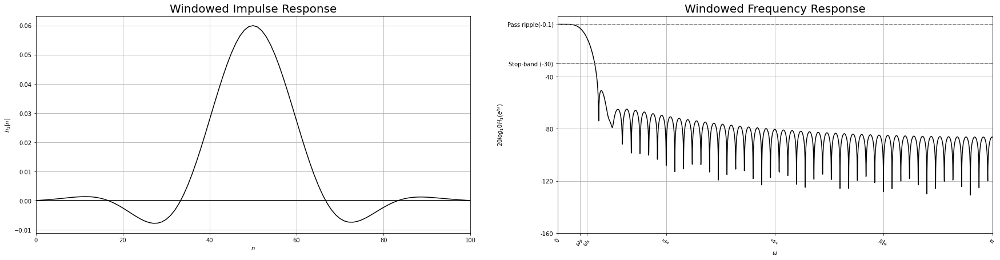

In [ ]:
wp = 0.052*np.pi 
ws = 0.068*np.pi

win_size = 100

h1 = windowing(h,win_size)
H1 = 20*np.log10(np.abs(np.fft.fft(h1)))

figure = plt.figure(figsize = (30,7))

figure.add_subplot(1,2,1)
plt.title("Windowed Impulse Response",fontsize = 20)
plt.xlabel("$n$",fontsize = 10)
plt.ylabel("$h_1[n]$",fontsize = 10)
plt.grid()
plt.xlim(0,win_size)
plt.plot(h1,color="k")
plt.axhline(color="k")


figure.add_subplot(1,2,2)
plt.title("Windowed Frequency Response",fontsize = 20)
plt.xlabel("$\omega$",fontsize = 10)
plt.ylabel(r"$20log_10 H_1(e^{j\omega})$",fontsize = 10)
plt.grid()
plt.plot(w,H1,color="k")
plt.xlim(0,3.14)
plt.xticks(*get_xticks(),fontsize = 10,rotation=60)
plt.axhline(y = -30, linestyle = "dashed",color="gray")
plt.axhline(y = -0.1, linestyle = "dashed",color="gray")
plt.yticks([-0.1,-30,-40,-80,-120,-160],["Pass ripple(-0.1)","Stop-band (-30)","-40","-80","-120","-160"])
plt.show()

As we can see, the filter order is not sufficient for the given pass band and stop band. Hence we will increase the filter order. Criteria is mean squared error. So we evaluate for different orders, find pass band magnitude, stop band magnitude, increase order if not satisfied

In [ ]:
Best_order = 20

for i in range(2,400,2):
  
  h1 = windowing(h,i)
  H1 = 20*np.log10(np.abs(np.fft.fft(h1)))
  
  wp_ind = np.where(np.abs(w-wp)<0.001)[0][0]

  ws_ind = np.where(np.abs(w-ws)<0.001)[0][0]

  Mag_wp = H1[wp_ind]
  Mag_ws = H1[ws_ind]

  if i%20 == 0:
    print("Order : ",i,"Magnitude at Pass edge = ",np.round(Mag_wp,4),"Magnitude at Stop edge = ",np.round(Mag_ws,4))

  if (Mag_wp > -0.1) and (Mag_ws < -30) :
    Best_order = i
    print("Best Filter order obtained : ",i)
    print("Magnitude at Pass edge now = ",Mag_wp,"Magnitude at Stop edge now = ",Mag_ws)
    break 

Order :  20 Magnitude at Pass edge =  -6.4364 Magnitude at Stop edge =  -7.5295
Order :  40 Magnitude at Pass edge =  -4.6345 Magnitude at Stop edge =  -7.557
Order :  60 Magnitude at Pass edge =  -4.0512 Magnitude at Stop edge =  -8.5106
Order :  80 Magnitude at Pass edge =  -3.5029 Magnitude at Stop edge =  -9.4245
Order :  100 Magnitude at Pass edge =  -3.0098 Magnitude at Stop edge =  -10.5141
Order :  120 Magnitude at Pass edge =  -2.5511 Magnitude at Stop edge =  -11.6524
Order :  140 Magnitude at Pass edge =  -2.1684 Magnitude at Stop edge =  -12.828
Order :  160 Magnitude at Pass edge =  -1.7963 Magnitude at Stop edge =  -14.203
Order :  180 Magnitude at Pass edge =  -1.5002 Magnitude at Stop edge =  -15.6
Order :  200 Magnitude at Pass edge =  -1.2136 Magnitude at Stop edge =  -17.1069
Order :  220 Magnitude at Pass edge =  -0.9858 Magnitude at Stop edge =  -18.8376
Order :  240 Magnitude at Pass edge =  -0.7776 Magnitude at Stop edge =  -20.572
Order :  260 Magnitude at Pass 

In [ ]:
print(Best_order)

366


Thus we got the best filter at an order of 366

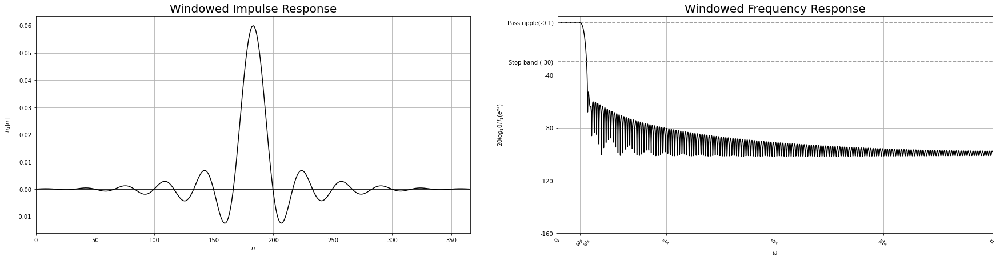

In [ ]:
win_size = Best_order

h1 = windowing(h,win_size)
H1 = 20*np.log10(np.abs(np.fft.fft(h1)))

figure = plt.figure(figsize = (30,7))

figure.add_subplot(1,2,1)
plt.title("Windowed Impulse Response",fontsize = 20)
plt.xlabel("$n$",fontsize = 10)
plt.ylabel("$h_1[n]$",fontsize = 10)
plt.grid()
plt.xlim(0,win_size)
plt.plot(h1,color="k")
plt.axhline(color="k")


figure.add_subplot(1,2,2)
plt.title("Windowed Frequency Response",fontsize = 20)
plt.xlabel("$\omega$",fontsize = 10)
plt.ylabel(r"$20log_10 H_1(e^{j\omega})$",fontsize = 10)
plt.grid()
plt.plot(w,H1,color="k")
plt.xlim(0,3.14)
plt.xticks(*get_xticks(),fontsize = 10,rotation=60)
plt.axhline(y = -30, linestyle = "dashed",color="gray")
plt.axhline(y = -0.1, linestyle = "dashed",color="gray")
plt.yticks([-0.1,-30,-40,-80,-120,-160],["Pass ripple(-0.1)","Stop-band (-30)","-40","-80","-120","-160"])
plt.show()

# Q2. Remez Filtering of Audio Signals 

## Qa. Getting the Remez Filters

In [ ]:
import gdown
import soundfile as sf
import scipy.signal
import IPython.display

!gdown --id 1JFL-lCqsRkRZWMCo9zvzE-UBgDT67taF

Downloading...
From: https://drive.google.com/uc?id=1JFL-lCqsRkRZWMCo9zvzE-UBgDT67taF
To: /content/Bach_-_Brandenburg_Concerto_No._3_-_1._Allegro.ogg
100% 9.90M/9.90M [00:00<00:00, 86.6MB/s]


Reading the audio and playing it.

In [ ]:
data, samplerate = sf.read(r'/content/Bach_-_Brandenburg_Concerto_No._3_-_1._Allegro.ogg')

t = 20

samples = 20*samplerate 

L_channel = data[0:samples,0]
R_channel = data[0:samples,1]

audio = np.concatenate((L_channel.reshape((1,-1)),R_channel.reshape((1,-1))),axis=0)

IPython.display.Audio(audio,rate=samplerate)

In [ ]:
def get_plot(Fs,w,h,title):

  w_axis = w*Fs*0.5 / np.pi
  h_axis = 20*np.log10(np.abs(h))
  plt.title(title)
  plt.plot(w_axis,h_axis,color="k")
  plt.grid()
  plt.axhline(color="k")
  plt.axvline(color="k")
  plt.xlabel(r"$f$")
  plt.ylabel(r"Magnitude in dB")

Remez Filters are obtained here

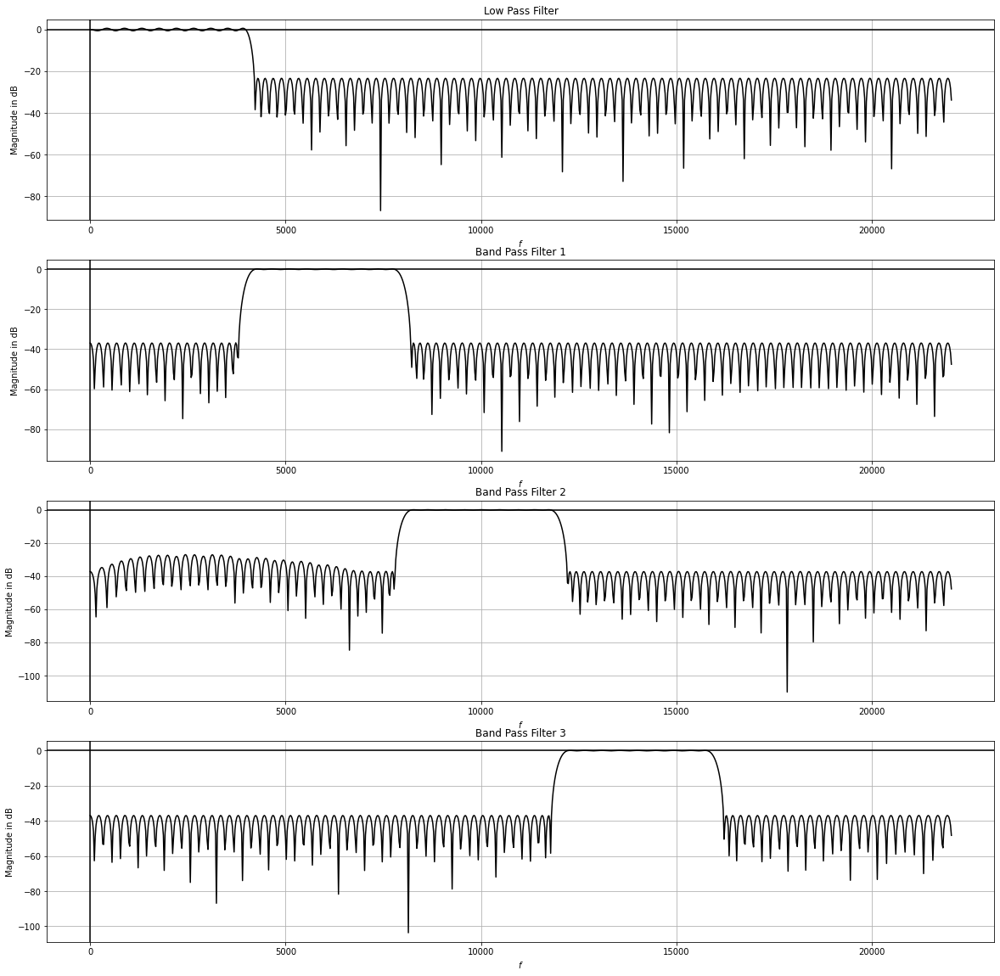

In [ ]:
Transition = 200

Fs = 44100
Fc1 = 4000

Fc2 = 4000
Fh2 = 8000

Fc3 = 8000
Fh3 = 12000

Fc4 = 12000
Fh4 = 16000

taps1 = scipy.signal.remez(200,bands = [0,Fc,Fc+Transition,0.5*Fs], desired = [1,0], Hz = Fs)
w1,h1 = scipy.signal.freqz(taps1,[1],worN = 1024)

taps2 = scipy.signal.remez(200,bands = [0,Fc2 - Transition,Fc2 + Transition,Fh2-Transition,Fh2+Transition,0.5*Fs], desired = [0,1,0], Hz = Fs)
w2,h2 = scipy.signal.freqz(taps2,[1],worN = 1024)

taps3 = scipy.signal.remez(200,bands = [0,Fc3 - Transition,Fc3 + Transition,Fh3-Transition,Fh3+Transition,0.5*Fs], desired = [0,1,0], Hz = Fs)
w3,h3 = scipy.signal.freqz(taps3,[1],worN = 1024)

taps4 = scipy.signal.remez(200,bands = [0,Fc4 - Transition,Fc4 + Transition,Fh4-Transition,Fh4+Transition,0.5*Fs], desired = [0,1,0], Hz = Fs)
w4,h4 = scipy.signal.freqz(taps4,[1],worN = 1024)

figure = plt.figure(figsize = (20,20))
figure.add_subplot(4,1,1)
get_plot(Fs, w1, h1, "Low Pass Filter")

figure.add_subplot(4,1,2)
get_plot(Fs, w2, h2, "Band Pass Filter 1")

figure.add_subplot(4,1,3)
get_plot(Fs, w3, h3, "Band Pass Filter 2")

figure.add_subplot(4,1,4)
get_plot(Fs, w4, h4, "Band Pass Filter 3")


In [ ]:
def get_plot_2(h,title):

  plt.title(title)
  plt.plot(np.abs(h),color="k")
  plt.grid()
  plt.axhline(color="k")
  plt.axvline(color="k")
  plt.xlabel(r"$f$")
  plt.ylabel(r"Magnitude in dB")

Time response for the above filters.

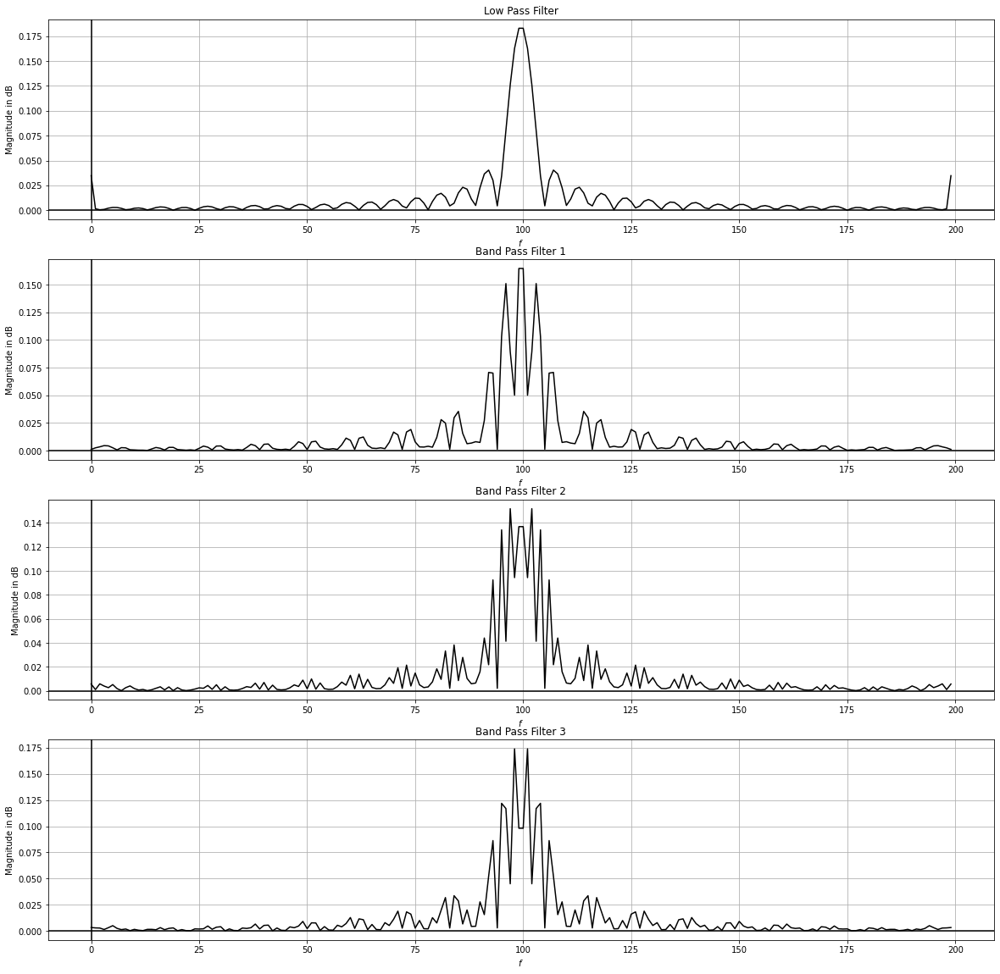

In [ ]:
figure = plt.figure(figsize = (20,20))
figure.add_subplot(4,1,1)
get_plot_2(taps1, "Low Pass Filter")

figure.add_subplot(4,1,2)
get_plot_2(taps2, "Band Pass Filter 1")

figure.add_subplot(4,1,3)
get_plot_2(taps3, "Band Pass Filter 2")

figure.add_subplot(4,1,4)
get_plot_2(taps4, "Band Pass Filter 3")
plt.show()

## Qb. Comparing the sounds

In [ ]:
y1_L = scipy.signal.convolve(L_channel,np.abs(h1),mode="full")
y1_R = scipy.signal.convolve(R_channel,np.abs(h1),mode="full")

y1 = np.concatenate((y1_L.reshape((1,-1)),y1_R.reshape((1,-1))),axis=0)

IPython.display.Audio(y1,rate=samplerate)

In [ ]:
y2_L = scipy.signal.convolve(L_channel,np.abs(h2),mode="full")
y2_R = scipy.signal.convolve(R_channel,np.abs(h2),mode="full")

y2 = np.concatenate((y2_L.reshape((1,-1)),y2_R.reshape((1,-1))),axis=0)

IPython.display.Audio(y2,rate=samplerate)

In [ ]:
y3_L = scipy.signal.convolve(L_channel,np.abs(h3),mode="full")
y3_R = scipy.signal.convolve(R_channel,np.abs(h3),mode="full")

y3 = np.concatenate((y3_L.reshape((1,-1)),y3_R.reshape((1,-1))),axis=0)

IPython.display.Audio(y3,rate=samplerate)

In [ ]:
y4_L = scipy.signal.convolve(L_channel,np.abs(h4),mode="full")
y4_R = scipy.signal.convolve(R_channel,np.abs(h4),mode="full")

y4 = np.concatenate((y4_L.reshape((1,-1)),y4_R.reshape((1,-1))),axis=0)

IPython.display.Audio(y4,rate=samplerate)

Here as we can observe from the above displayed audio signals, There is noticeable difference between the low pass filter output of the audio signal followed by slight or negligible difference in the output of the audio signal for other band pass filters. Especially the sound of triangle is removed in the output of the low pass filter.
